Found 1858 images belonging to 102 classes.


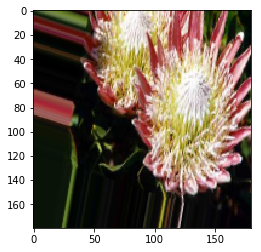

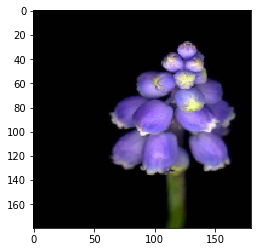

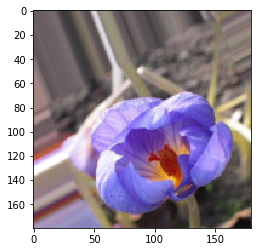

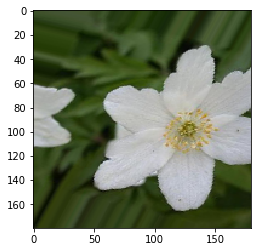

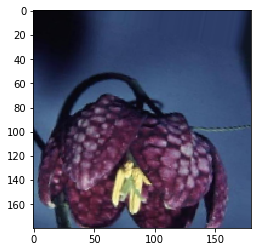

...

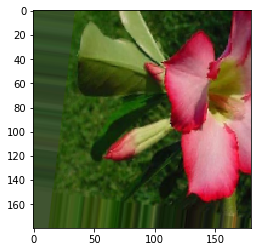

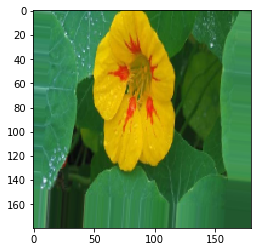

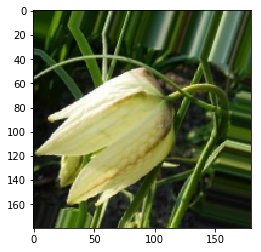

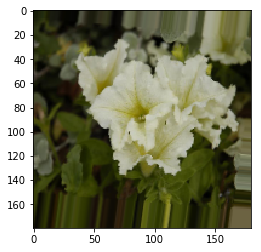

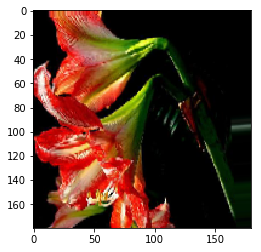

In [1]:
from matplotlib import pyplot as plt
%matplotlib inline

from keras_preprocessing.image import ImageDataGenerator

img_height = img_width = 180

train_valid_combined_dir = '../data/processed/train-valid-combine'



from imblearn.keras import BalancedBatchGenerator
from imblearn.under_sampling import NearMiss

training_generator = BalancedBatchGenerator(X, y, sampler=NearMiss(), batch_size=10, random_state=42)


# train_data_generator = ImageDataGenerator(rescale=1./255, rotation_range=25, width_shift_range=0.2,
# 	height_shift_range=0.2, shear_range=0.1, zoom_range=0.3, horizontal_flip=True, fill_mode="nearest", 
#                                           validation_split=0.1)


train_data_generator = ImageDataGenerator(rescale=1./255, validation_split=0.1)

class_names = [str(i+1) for i in range(102)]
print(class_names)

train_data = train_data_generator.flow_from_directory(train_valid_combined_dir, 
                                                      subset='training', seed=42, target_size=(img_height, img_width), 
                                                      classes=class_names, class_mode='categorical')


for batch in range(0,10):
    x,y = train_data.next()
    for i in range(0,32):
        image = x[i]
        plt.imshow(image)
        plt.show()